# **Task 1**

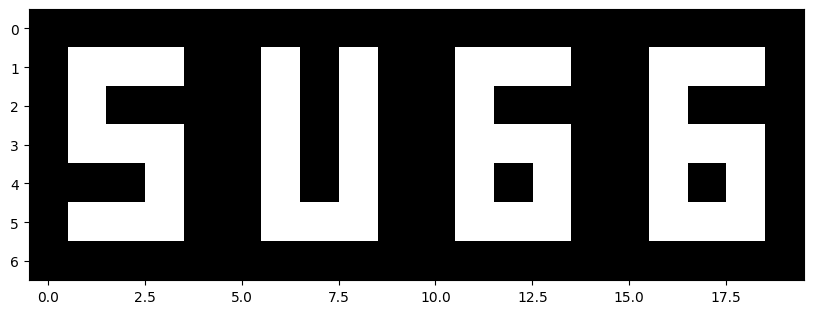

In [ ]:
# Task 1

import numpy as np
import matplotlib.pyplot as plt
import cv2

# SU66
letter_S = np.array([
                [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0],
                [0,255,255,255,0,0,255,0,255,0,0,255,255,255,0,0,255,255,255,0],
                [0,255,0,0,0,0,255,0,255,0,0,255,0,0,0,0,255,0,0,0],
                [0,255,255,255,0,0,255,0,255,0,0,255,255,255,0,0,255,255,255,0],
                [0,0,0,255,0,0,255,0,255,0,0,255,0,255,0,0,255,0,255,0],
                [0,255,255,255,0,0,255,255,255,0,0,255,255,255,0,0,255,255,255,0],
                [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0]
                ])


plt.figure(figsize=(10,5))
plt.imshow(letter_S, cmap='gray')

# **Task 2**

In [ ]:
# Task 2
import os
import numpy as np
import matplotlib.pyplot as plt
import cv2

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
dataset_1 = "/content/drive/MyDrive/Lab1/Task 2/Dataset_1"
noise_dataset = "/content/drive/MyDrive/Lab1/Task 2/Noise_dataset"
os.makedirs(noise_dataset, exist_ok = True)

In [ ]:
car_list = os.listdir(dataset_1)
print(car_list)

['Screenshot 2025-10-24 113558.png', 'Screenshot 2025-10-24 113623.png', 'Screenshot 2025-10-24 113629.png', 'Screenshot 2025-10-24 113634.png', 'Screenshot 2025-10-24 113640.png', 'Screenshot 2025-10-24 113645.png', 'Screenshot 2025-10-24 113651.png', 'Screenshot 2025-10-24 113700.png', 'Screenshot 2025-10-24 113706.png', 'Screenshot 2025-10-24 114056.png']


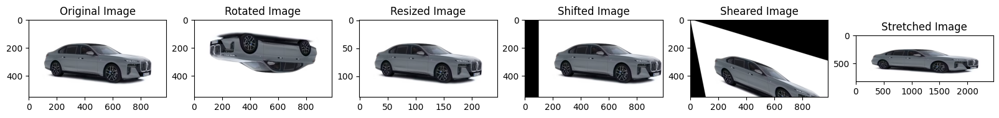

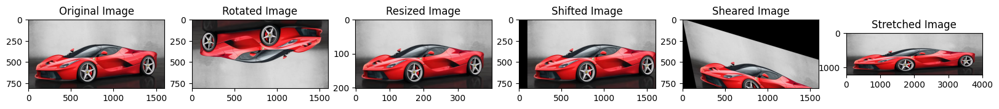

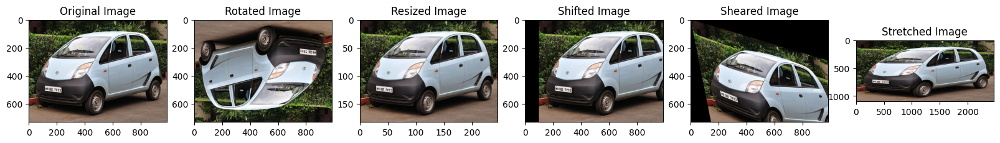

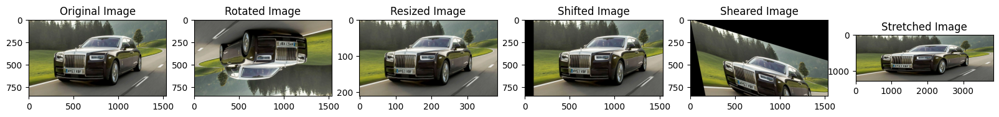

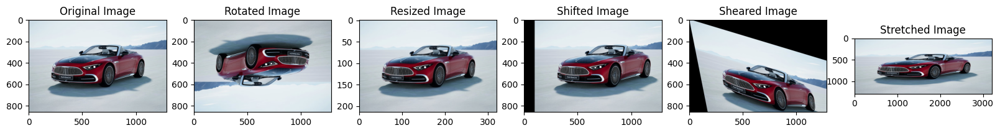

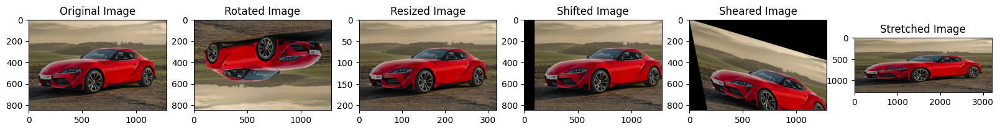

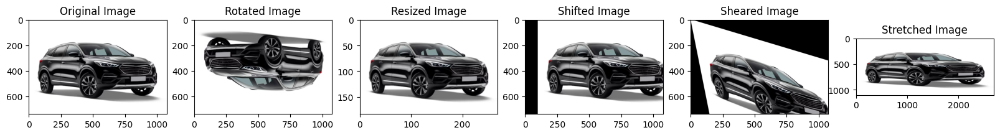

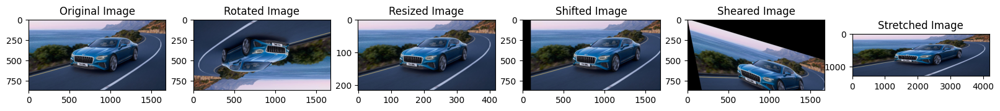

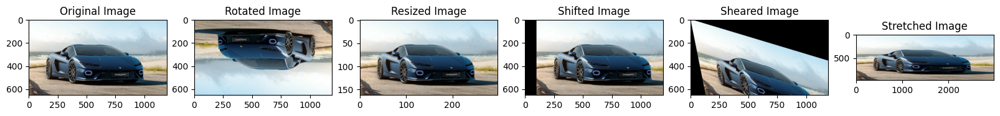

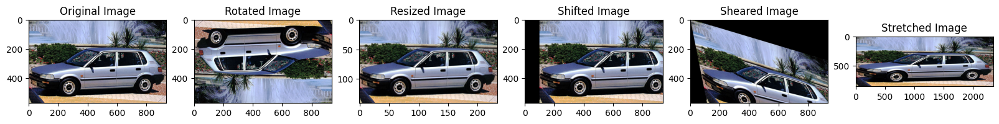

In [ ]:
for cars in os.listdir(dataset_1):
    if cars.endswith(('.png','.jpg','.jpeg')):
        path = os.path.join(dataset_1, cars)
        image = cv2.imread(path)
        if image is not None:
            image =  cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            rows, cols = image.shape[:2]

            # Rotation

            # It rotates the image around a point and shows it from a different angle

            rotation_matrix = cv2.getRotationMatrix2D((cols/2, rows/2), 180,1)
            rotated_image = cv2.warpAffine(image, rotation_matrix, (cols, rows))

            # Resizing

            # Using resizing we can enlarge or shrink the image  and thus we have control its dimensions

            new_dim = (int(cols*0.25), int(rows*0.25))
            resized_image = cv2.resize(image, new_dim, interpolation=cv2.INTER_AREA)

            # Shift

            # Shifting moves the image from x and y axis

            translaton_matrix = np.float32([
                [1, 0, 100],
                [0, 1, 0]
                ])

            shifted_image = cv2.warpAffine(image, translaton_matrix, (cols, rows))

            # Shear

            # Pixels are displaced in proportion to their distance from an axis, making a skewed version of the image

            shear_matrix = np.float32([
                [1, 0.2, 0],
                [0.3, 1, 0]
                ])

            sheared_image = cv2.warpAffine(image, shear_matrix, (cols, rows))


            # Stretch

            # It widens the image along an axis and thus gives a different view or perspective of it

            x = 2.5
            y = 1.5
            stretch_matrix = np.float32([
                [x, 0, 0],
                [0, y, 0]
                ])

            stretched_image = cv2.warpAffine(image, stretch_matrix, (int(cols * x), int(rows * y)))


            f, (og, rotated, resized, shifted, sheared, stretched) = plt.subplots(1, 6, figsize = (20,10))
            og.set_title( "Original Image")
            rotated.set_title("Rotated Image")
            resized.set_title("Resized Image")
            shifted.set_title("Shifted Image")
            sheared.set_title("Sheared Image")
            stretched.set_title("Stretched Image")
            og.imshow(image)
            rotated.imshow(rotated_image)
            resized.imshow(resized_image)
            shifted.imshow(shifted_image)
            sheared.imshow(sheared_image)
            stretched.imshow(stretched_image)



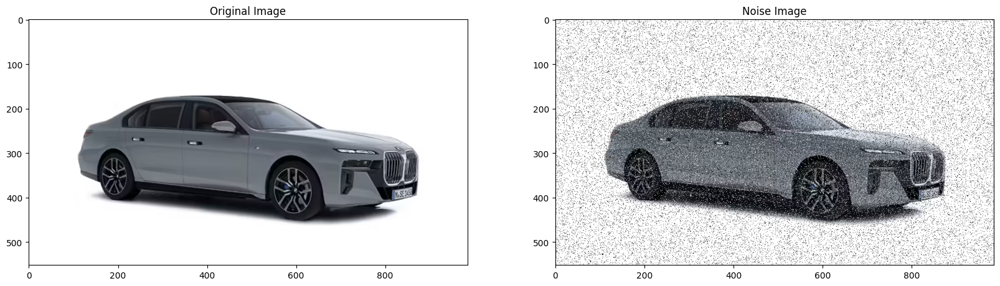

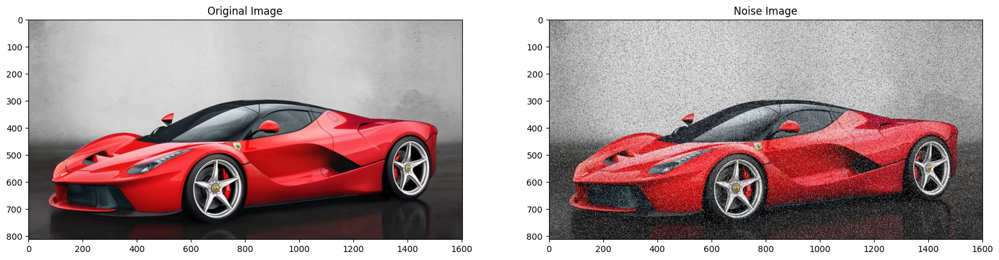

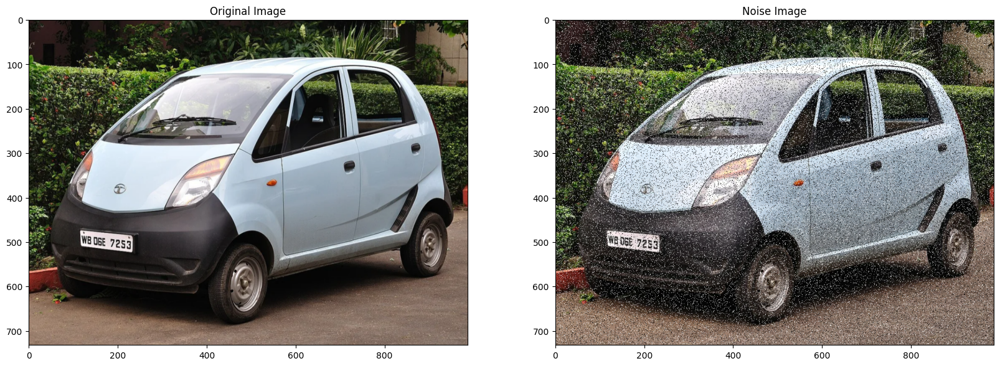

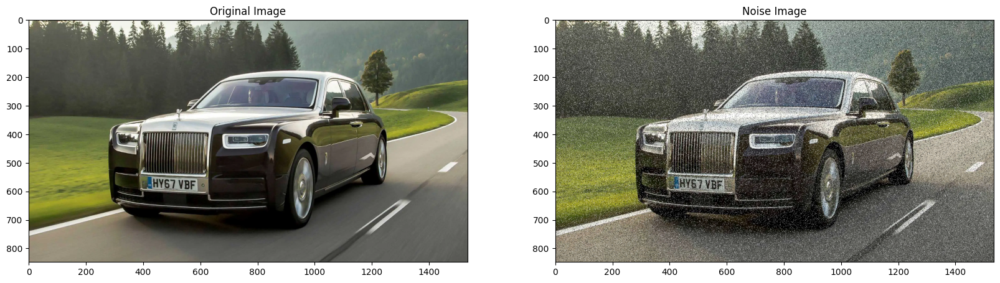

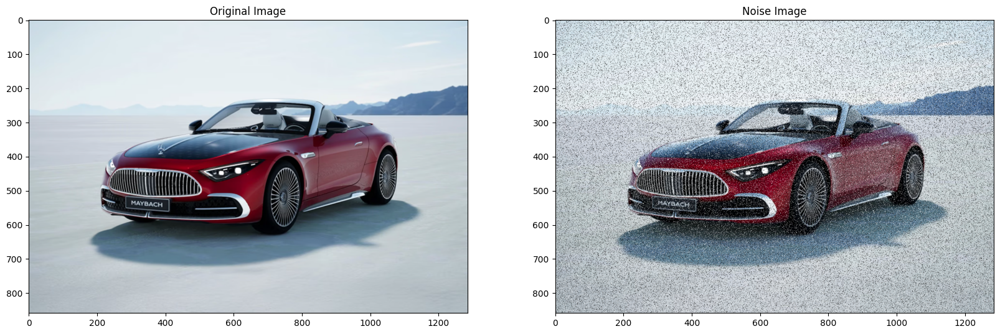

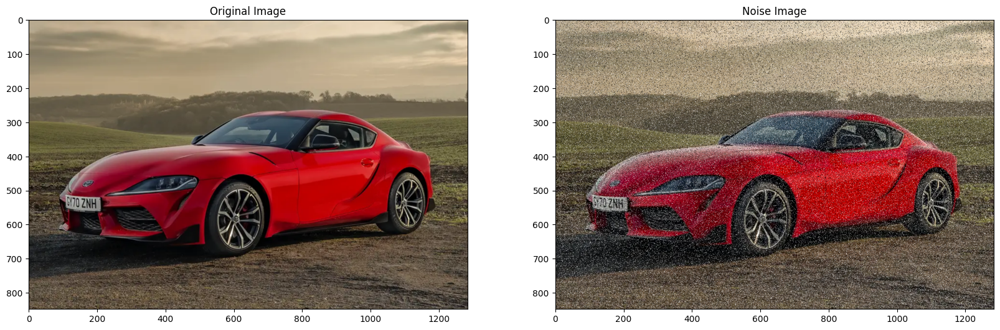

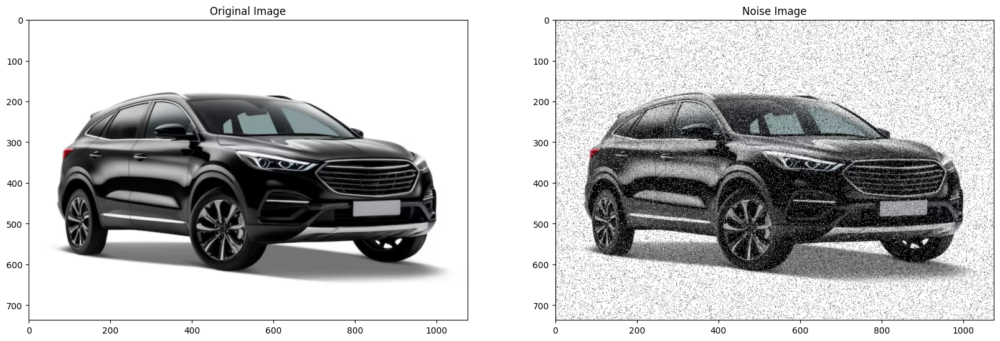

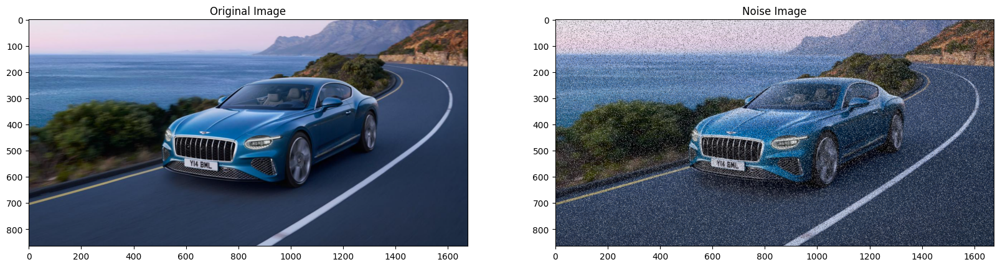

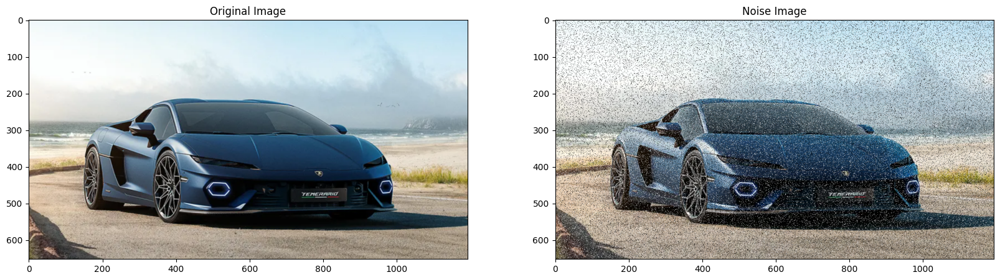

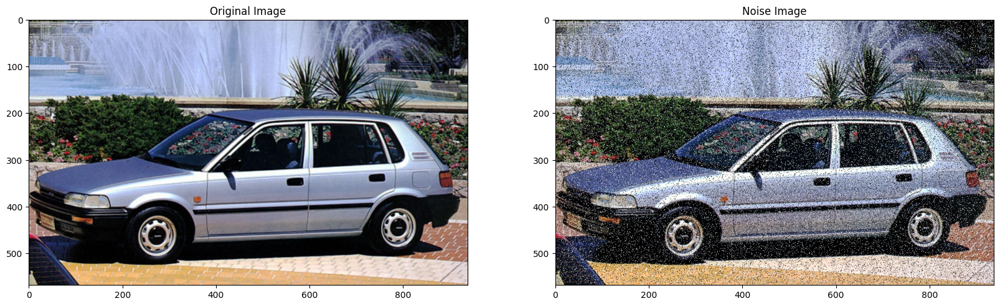

In [ ]:
# Adding Random Noise
coords_list = []
for cars in os.listdir(dataset_1):
    if cars.endswith(('.png','.jpg','.jpeg')):
        path = os.path.join(dataset_1, cars)
        image = cv2.imread(path)
        if image is not None:
            image =  cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            rows, cols,channels = image.shape[:3]

            # Salt and paper noise

            probability = 0.05

            salts = np.ceil(probability * image.size * 0.5).astype(int)
            papers = np.ceil(probability * image.size * 0.5).astype(int)

            image_noised = np.copy(image)

            coords_salt = [np.random.randint(0,i-1, salts) for i in image.shape]
            image_noised[coords_salt[0], coords_salt[1]] = 255

            coords_paper = [np.random.randint(0,i-1, papers) for i in image.shape]
            image_noised[coords_paper[0], coords_paper[1]] = 0


            coords_list.append(image_noised)

            # saving
            path1 = os.path.join(noise_dataset, cars)
            plt.imsave(path1, image_noised)
            f, (og, noised) = plt.subplots(1, 2, figsize = (20,10))
            og.set_title( "Original Image")
            noised.set_title( "Noise Image")
            og.imshow(image)
            noised.imshow(image_noised)
            plt.show()
            plt.close()



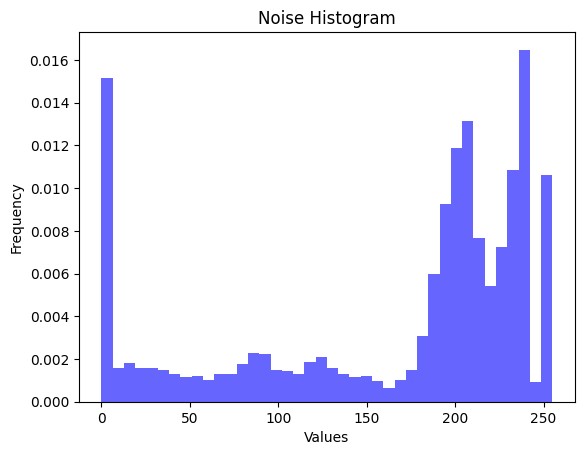

In [ ]:
# plotting histogram
import random

noise_image = random.choice(coords_list)

flat = noise_image.flatten()

plt.hist(flat, bins = 40, density = True, alpha = 0.6, color = 'b')

plt.title("Noise Histogram")

plt.ylabel('Frequency')

plt.xlabel('Values')

plt.show()
plt.close()


# **Task 3**

In [ ]:
# Task 3

import os
import numpy as np
import matplotlib.pyplot as plt
import cv2


nature = "/content/drive/MyDrive/Lab1/Task 3/nature"

os.makedirs(nature, exist_ok = True)

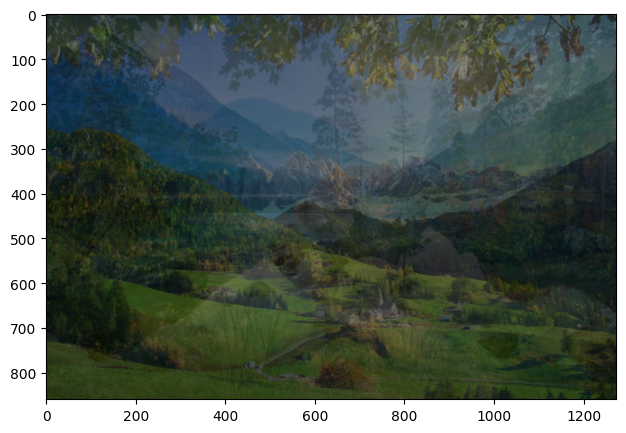

In [ ]:
blended_image = None
blend = 0.20
dim = [0,0]
counts = 0

for pics in os.listdir(nature):
    if pics.endswith(('.png','.jpg','.jpeg')):
        path = os.path.join(nature, pics)
        image = cv2.imread(path)
        if image is not None:
            image =  cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

            rows, cols = image.shape[:2]

            if dim[0] == 0 and dim[1] == 0 and not blended_image:
                dim = (cols, rows)
                blended_image = image * blend
            else:

                resized_image = cv2.resize(image, tuple(dim), interpolation=cv2.INTER_AREA)

                blended_image = blended_image + resized_image * blend
            blend += 0.20
            counts += 1




blended_image = np.clip(blended_image / counts, 0, 255).astype(np.uint8)
plt.figure(figsize = (20,5))
plt.imshow(blended_image)
plt.show()



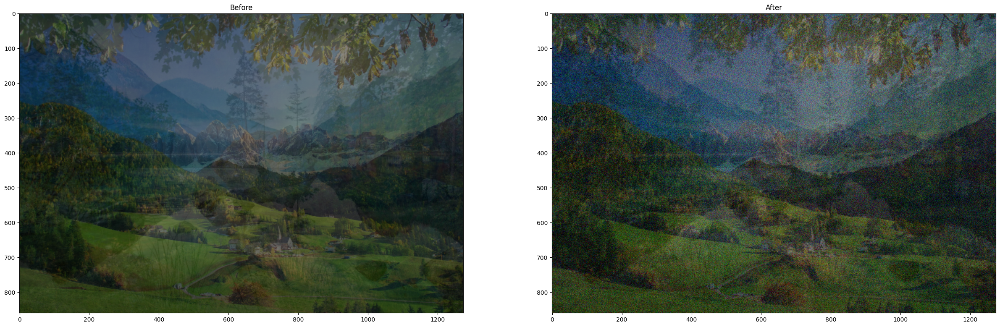

In [ ]:
# gaussian noise

mean = 0
standard_dev = 5

gaussian_noise = np.random.normal(mean, standard_dev, blended_image.shape)


noised_blended_image = np.clip((blended_image+ gaussian_noise*5), 0, 255).astype(np.uint8)

f,(before, after) = plt.subplots(1,2, figsize = (30,10))
before.set_title("Before")
after.set_title("After")
before.imshow(blended_image)
after.imshow(noised_blended_image)


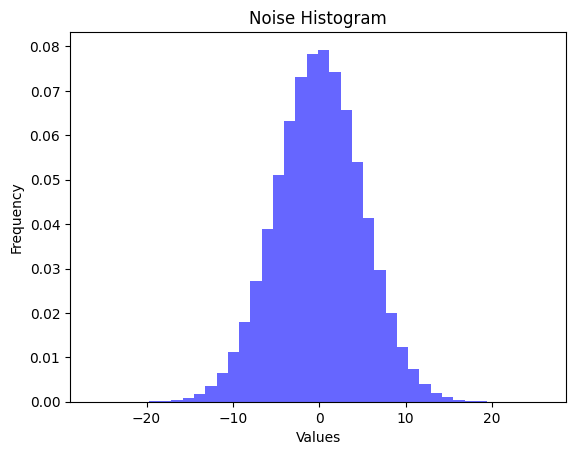

In [ ]:
# plotting histogram

noise = gaussian_noise

flat = np.array(noise).flatten()

plt.hist(flat, bins = 40, density = True, alpha = 0.6, color = 'b')

plt.title("Noise Histogram")

plt.ylabel('Frequency')

plt.xlabel('Values')

plt.show()
plt.close()
